<a href="https://colab.research.google.com/github/mascDriver/data-science/blob/main/GEX637_Trabalho_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

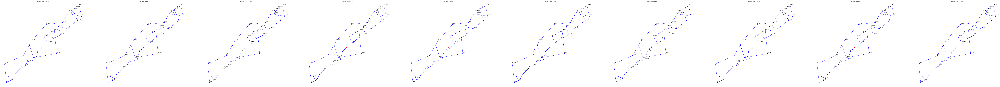

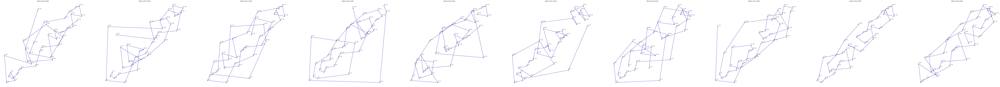

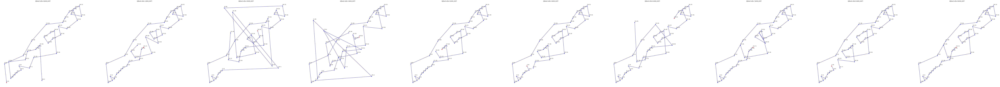

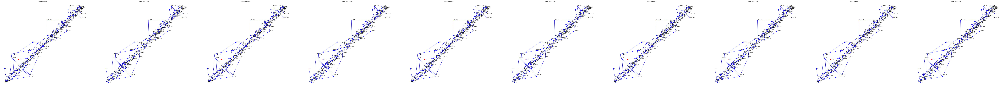

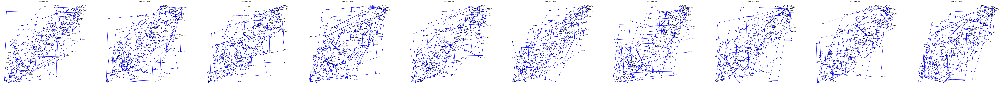

...

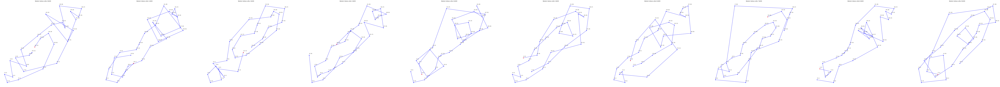

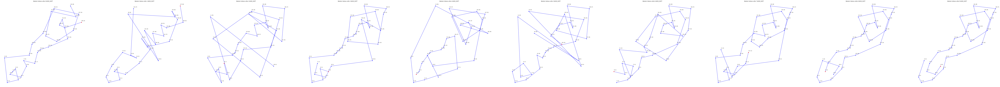

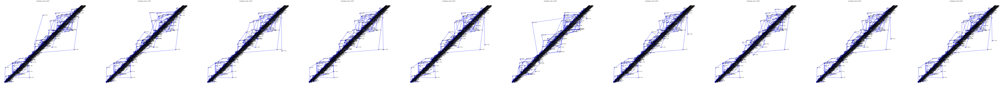

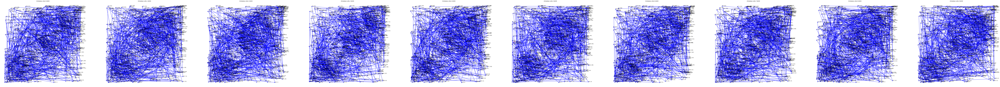

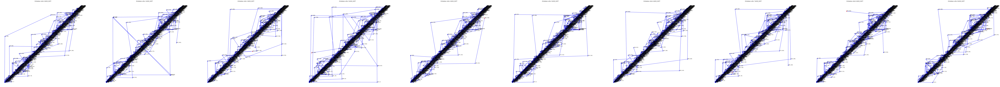

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
import os
from scipy.spatial import distance_matrix
import random

instances = {
    "dj38.tsp": "Djibouti",
    "qa194.tsp": "Qatar",
    "uy734.tsp": "Uruguay",
    "wi29.tsp": "Western Sahara",
    "zi929.tsp": "Zimbabwe",
}

path = '/content/drive/MyDrive/GEX637/'

class Tsp():
  def read_tsp(self, filename: str) -> None:
    with open(filename) as f:
        node_coord_start = None
        dimension = None
        lines = f.readlines()
        i = 0
        while not dimension or not node_coord_start:
            line = lines[i]
            if line.startswith('DIMENSION :') or line.startswith('DIMENSION:'):
                dimension = int(line.split()[-1])
                self.dimension = dimension
            if line.startswith('NODE_COORD_SECTION'):
                node_coord_start = i
            i = i+1
        f.seek(0)
        cities = pd.read_csv(
            f,
            skiprows=node_coord_start + 1,
            sep=' ',
            names=['city', 'x', 'y'],
            dtype={'city': str, 'x': np.float64, 'y': np.float64},
            header=None,
            nrows=dimension
        )
        self.cities = cities

  def matrix(self) -> list:
    self.matrix_distance = distance_matrix(self.cities[['x', 'y']].values, self.cities[['x', 'y']].values)
  
class AgoxShift:
  def __init__(self, tsp: Tsp) -> None:
    self.matrix_distance = tsp.matrix_distance
    self.dimension = tsp.dimension
    self.timeout = (self.dimension*90)/1000
    self.best_quality = 0
    self.__exec_shift = False
    self.best_path = list()

  def shiftChild(self, protoChild: list) -> list:
    proto_child_search = protoChild.copy()
    proto_child_search = list(dict.fromkeys(proto_child_search))
    city = proto_child_search.pop(0)
    proto_child_shift = [city]
    while len(proto_child_search) > 0:
      distance = float('inf')
      for city_neighborhood in proto_child_search:
        if self.matrix_distance[city][city_neighborhood] < distance:
          best_neighborhood = city_neighborhood
          distance = self.matrix_distance[city][city_neighborhood]
      if best_neighborhood not in proto_child_shift:
        city = best_neighborhood
        proto_child_shift.append(best_neighborhood)
        proto_child_search.remove(best_neighborhood)
    return proto_child_shift

  def getChild(self, p1: list, p2: list) -> list:
    c1 = np.random.randint(self.dimension)
    c2 = np.random.randint(self.dimension)

    if(c2 >= c1):
        c2 += 1
    else:
        c1, c2 = c2, c1

    protoChild = []
    protoChild[c1:c2] = p1[c1:c2]
    # TODO - Precisa implementar aqui a busca local ou construtiva no protoChild
    if len(protoChild) > 1 and self.__exec_shift:
      protoChild = self.shiftChild(protoChild)
      
    
    for index, value in enumerate(p1[c1:c2]):
        p2 = np.delete(p2, np.argwhere(p2 == value))

    protoChild = [*p2[:c1], *protoChild]
    protoChild = [*protoChild, *p2[c1:]]


    return protoChild


  def getQuality(self, actualSolution: list) -> float:
    actualQuality = 0
    for key, value in enumerate(actualSolution):
      actualQuality += self.matrix_distance[value][actualSolution[(key+1) % (self.dimension)]]
    return actualQuality


  def getShiftSearch(self) -> None:
    elapsedTime = 0
    t1 = time.perf_counter()
    best_quality_shift = float('inf')
    best_path_shift = list()
    while(elapsedTime < self.timeout):
      vector_random = np.arange(self.dimension)
      np.random.shuffle(vector_random)
      best_way = self.shiftChild(vector_random)
      quality_of_best_way = self.getQuality(best_way)
      if quality_of_best_way < best_quality_shift:
        best_quality_shift = quality_of_best_way
        best_path_shift = best_way
      elapsedTime = time.perf_counter() - t1
    self.best_quality = best_quality_shift
    self.best_path = best_path_shift

  def getBestSolution(self) -> None:
    elapsedTime = 0
    t1 = time.perf_counter()
    n = round(np.sqrt(self.dimension))
    if n % 2 > 0:
        n += 1
    population = []
    for i in range(n):
        p = np.arange(self.dimension)
        np.random.shuffle(p)
        population.append(p.tolist())

    while(elapsedTime < self.timeout):
        childGeneration = []
        parentGeneration = []

        # gera a população de filhos
        while len(population) > 0:
            # remove 2 pais da população (atualmente está pegando de forma sequencial, não de forma aleatória)
            p1 = population.pop()
            p2 = population.pop()
            parentGeneration.append(p1)
            parentGeneration.append(p2)

            # realiza a recombinação dos pais para gerar os filhos
            ch1 = self.getChild(p1, p2)
            ch2 = self.getChild(p2, p1)
            childGeneration.append(ch1)
            childGeneration.append(ch2)
        # calcula o tamanho da mutação
        mutationLength = round(len(childGeneration)*0.2)
        np.random.shuffle(childGeneration)

        # gera a mutação
        for i in range(mutationLength):
            node1 = np.random.randint(0, self.dimension)
            node2 = np.random.randint(0, self.dimension)
            while (node1 == node2):
                node2 = np.random.randint(0, self.dimension)
            childGeneration[i][node1], childGeneration[i][node2] = childGeneration[i][node2], childGeneration[i][node1]

        # calcula o tamanho da seleção
        childGenerationLength = round(len(childGeneration)*0.8)
        parentGenerationLength = len(parentGeneration) - childGenerationLength

        # classifica as melhores solução da população de filhos gerados
        childBestGenerations = []
        qualities = []
        for i, actualSolution in enumerate(childGeneration):
            qualities.append(
                [self.getQuality(actualSolution), actualSolution])
        qualities.sort(key=lambda path: path[0])
        for cost, solution in qualities:
            childBestGenerations.append(solution)

        # classifica as melhores solução da população de fpais
        parentBestGeneartions = []
        qualities = []
        for i, actualSolution in enumerate(parentGeneration):
            qualities.append(
                [self.getQuality(actualSolution), actualSolution])
        qualities.sort(key=lambda path: path[0])
        for cost, solution in qualities:
            parentBestGeneartions.append(solution)

        # gera a nova população pegando as melhores soluções da população pai e da população filho conforme o tamanho da seleção
        population = parentBestGeneartions[:parentGenerationLength] + \
            childBestGenerations[:childGenerationLength]

        elapsedTime = time.perf_counter() - t1

    for i, actualSolution in enumerate(population):
        qualities.append(
            [self.getQuality(actualSolution), actualSolution])

    self.best_quality = qualities[0][0]
    self.best_path = actualSolution
    

  def run(self) -> None:
    self.getBestSolution()

  def runWithShift(self) -> None:
    self.__exec_shift = True
    self.getBestSolution()

  def runShift(self) -> None:
    self.__exec_shift = True
    self.getShiftSearch()
  
def plot_tour(tour, axes, length, style='bo-'): 
    "Plot every city and link in the tour, and highlight start city."
    plot_segment(tour, axes, length, style)
    axes.plot(tour[0], tour[1],  'rD-', clip_on=False)
    
def plot_segment(segment, axes, length, style='bo-'):
    "Plot every city and link in the segment."
    x, y = [c for c in segment], [segment[(key+1) % (length)] for key, c in enumerate(segment)]
    axes.plot(x, y, style, clip_on=False)
    axes.axis('scaled')
    axes.axis('off')
    for i, j in zip(x, y):
      axes.text(i, j+0.5, '({}, {})'.format(i, j))



def main():
  resultados = []
  max_figsize = 800
  for filename in os.scandir(path):
    # if not filename.name in instances: continue
    # if filename.name != 'wi29.tsp': continue
    tsp = Tsp() # instancia a class responsavel por arquivos tsp
    tsp.read_tsp(filename) # extrai os dados necessarios para utilizar no cod
    tsp.matrix() # cria matriz de distancias euclidianas

    quality = []
    quality_shift = []
    time_execution = []
    fig, axes = plt.subplots(nrows=1, ncols=10, figsize=(200, 125))
    for _ in range(10):
      agox_shift = AgoxShift(tsp) # instancia busca
      t = time.perf_counter()
      agox_shift.runShift()
      quality.append(agox_shift.best_quality)
      time_execution.append(time.perf_counter() - t)
      axes[_].set_title(f'{instances[filename.name]} volta {_} SHIFT')
      plot_tour(agox_shift.best_path, axes[_], agox_shift.dimension)

    resultados.append({
        'instancia': instances[filename.name],
        'autoria': 'Diogo.Baltazar e Nicolas',
        'algoritmo': 'SHIFT',
        'q-medio': round(np.mean(quality)),
        'q-desvio': round(np.std(quality), 2),
        't-medio': round(np.mean(time_execution))
    })

    quality = []
    quality_shift = []
    time_execution = []
    fig, axes = plt.subplots(nrows=1, ncols=10, figsize=(200, 125))
    for _ in range(10):
      agox_shift = AgoxShift(tsp) # instancia busca
      t = time.perf_counter()
      agox_shift.run()
      quality.append(agox_shift.best_quality)
      time_execution.append(time.perf_counter() - t)
      axes[_].set_title(f'{instances[filename.name]} volta {_} AGOX')
      plot_tour(agox_shift.best_path, axes[_], agox_shift.dimension)

    resultados.append({
        'instancia': instances[filename.name],
        'autoria': 'Diogo.Baltazar e Nicolas',
        'algoritmo': 'AGOX',
        'q-medio': round(np.mean(quality)),
        'q-desvio': round(np.std(quality), 2),
        't-medio': round(np.mean(time_execution))
    })

    quality = []
    quality_shift = []
    time_execution = []
    fig, axes = plt.subplots(nrows=1, ncols=10, figsize=(200, 125))
    for _ in range(10):
      agox_shift = AgoxShift(tsp) # instancia busca
      t = time.perf_counter()
      agox_shift.runWithShift()
      quality.append(agox_shift.best_quality)
      time_execution.append(time.perf_counter() - t)
      axes[_].set_title(f'{instances[filename.name]} volta {_} AGOX_SHIFT')
      plot_tour(agox_shift.best_path, axes[_], agox_shift.dimension)

    resultados.append({
        'instancia': instances[filename.name],
        'autoria': 'Diogo.Baltazar e Nicolas',
        'algoritmo': 'AGOX_SHIFT',
        'q-medio': round(np.mean(quality)),
        'q-desvio': round(np.std(quality), 2),
        't-medio': round(np.mean(time_execution))
    })
  pd.DataFrame(resultados).to_csv('resultados.csv', index=False)
main()

In [ ]:
pd.read_csv('resultados.csv')

,instancia,autoria,algoritmo,q-medio,q-desvio,t-medio
0,Djibouti,Diogo.Baltazar e Nicolas,SHIFT,6770,0.00,3
1,Djibouti,Diogo.Baltazar e Nicolas,AGOX,10351,985.46,3
2,Djibouti,Diogo.Baltazar e Nicolas,AGOX_SHIFT,6984,438.48,3
3,Qatar,Diogo.Baltazar e Nicolas,SHIFT,11330,0.00,17
4,Qatar,Diogo.Baltazar e Nicolas,AGOX,41974,1090.44,17
5,Qatar,Diogo.Baltazar e Nicolas,AGOX_SHIFT,12138,343.89,18
6,Uruguay,Diogo.Baltazar e Nicolas,SHIFT,95265,627.47,66
7,Uruguay,Diogo.Baltazar e Nicolas,AGOX,1060740,23126.33,66
8,Uruguay,Diogo.Baltazar e Nicolas,AGOX_SHIFT,101394,1572.58,67
9,Western Sahara,Diogo.Baltazar e Nicolas,SHIFT,32161,0.00,3


In [ ]:
pd.DataFrame([{'instancia': 'dj38', 'q-medio': 6656}, {'instancia': 'qa194', 'q-medio': 9352}, {'instancia': 'uy734', 'q-medio': 79114}, {'instancia': 'wi29', 'q-medio': 27603}, {'instancia': 'zi929', 'q-medio': 95345}])

,instancia,q-medio
0,dj38,6656
1,qa194,9352
2,uy734,79114
3,wi29,27603
4,zi929,95345
